## Dog Breed Classification

In this project we will use traditional CNN, CNN with data augmentation and finally transfer Learning by VGG16 model with weights pre-trained on Imagenet to solve the dog breed classification problem

### Load Dataset Files

In [0]:
import pandas as pd
import numpy as np

In [0]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/Content/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /Content/


In [0]:
!ls "/Content/My Drive/Content"

labels.csv.zip		   train.zip
sample_submission.csv.zip  vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5
test.zip


Now, upload the given dataset file shared with you in your google drive and give its path for the below given `project_path` variable. For example, a path is given below according to the file path in our google drive. You need to change this to match the path of yours.

In [0]:
project_path = "/Content/My Drive/Content/"

Run the below code to extract all the images in the train.zip files given in the dataset. We are going to use these images as train and validation sets and their labels in further steps.

In [0]:
from zipfile import ZipFile
with ZipFile(project_path+'test.zip', 'r') as z:
  z.extractall()

Repeat the same step for test.zip

In [0]:
from zipfile import ZipFile
with ZipFile(project_path+'sample_submission.csv.zip', 'r') as z:
  z.extractall()

Repeat the same step for sample_submission.csv.zip

In [0]:
from zipfile import ZipFile
with ZipFile(project_path+'labels.csv.zip', 'r') as z:
  z.extractall()

Repeat the same step for labels.csv.zip

In [0]:
from zipfile import ZipFile
with ZipFile(project_path+'train.zip', 'r') as z:
  z.extractall()

After this process, we will have 4 files - Train folder, test folder and labels.csv and sample_submission.csv as part of your google drive

### Read labels.csv file using pandas

In [0]:
labels = pd.read_csv('labels.csv')

In [0]:
labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


### Print the count of each category of Dogs given in the dataset



In [0]:
labels['breed'].value_counts()

scottish_deerhound                126
maltese_dog                       117
afghan_hound                      116
entlebucher                       115
bernese_mountain_dog              114
shih-tzu                          112
great_pyrenees                    111
pomeranian                        111
basenji                           110
samoyed                           109
airedale                          107
tibetan_terrier                   107
leonberg                          106
cairn                             106
beagle                            105
japanese_spaniel                  105
blenheim_spaniel                  102
australian_terrier                102
miniature_pinscher                102
irish_wolfhound                   101
saluki                             99
lakeland_terrier                   99
papillon                           96
siberian_husky                     95
whippet                            95
norwegian_elkhound                 95
pug         

### Get one-hot encodings of labels

In [0]:
import numpy as np
targets = pd.Series(labels['breed'])
one_hot = pd.get_dummies(targets, sparse = True)
one_hot_labels = np.asarray(one_hot)

In [0]:
one_hot_labels[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=uint8)

In [0]:
from sklearn.preprocessing import LabelEncoder

In [0]:
le_class = LabelEncoder()
labels["breed"] = le_class.fit_transform(labels["breed"])


In [0]:
labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,19
1,001513dfcb2ffafc82cccf4d8bbaba97,37
2,001cdf01b096e06d78e9e5112d419397,85
3,00214f311d5d2247d5dfe4fe24b2303d,15
4,0021f9ceb3235effd7fcde7f7538ed62,49


## Preparing training dataset
1. Write a code which reads each and every id from labels.csv file and loads the corresponding image (in RGB - 128, 128, 3) from the train folder. <br>
2. Create 2 variables <br> 
     a.  x_train - Should have all the images of the dogs from train folder <br>
     b.  y_train - Corresponding label of the dog <br>
<u>Note:</u> The id of the dog images and its corresponding labels are available in labels.csv file   
<u>Hint:</u> Watch the video shared on "Preparing the training dataset" if you face issue on creating the training dataset

In [0]:
from tqdm import tqdm
import cv2

In [0]:
img_rows=128
img_cols=128
num_of_channels = 1

In [0]:
x_feature = []
y_feature = []
y_label = []

In [0]:
i = 0 
for f, img in tqdm(labels.values): 
    train_img = cv2.imread('./train/{}.jpg'.format(f),0)
    label = one_hot_labels[i]
    train_img_resize = cv2.resize(train_img, (img_rows, img_cols)) 
    x_feature.append(train_img_resize)
    y_feature.append(label)
    y_label.append(img)
    i += 1

100%|██████████| 10222/10222 [00:13<00:00, 759.04it/s]


Normalize the training data and convert into 4 dimensions so that it can be used as an input to conv layers in the model

In [0]:
y_feature[120]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=uint8)

In [0]:
y_label[120]

57

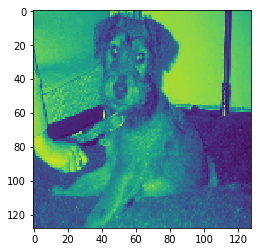

In [0]:
import matplotlib.pyplot as plt
plt.imshow(x_feature[120])

In [0]:
#normalize the data to pass it on to convolution layer
x_train_data = np.array(x_feature, np.float32) / 255.  
print (x_train_data.shape)
x_train_data = np.expand_dims(x_train_data, axis = 3) 
print (x_train_data.shape)

(10222, 128, 128)
(10222, 128, 128, 1)


In [0]:
y_train_data = np.array(y_feature)

y_train_data.shape

(10222, 120)

### Split the training and validation data from `x_train_data` and `y_train_data` obtained from above step

In [0]:
from sklearn.model_selection import train_test_split



In [0]:
from sklearn.model_selection import train_test_split
x_train, x_val, y_train, y_val = train_test_split(x_train_data, y_train_data, test_size=0.2, random_state=2)
print (x_train.shape)
print (x_val.shape)

(8177, 128, 128, 1)
(2045, 128, 128, 1)


### Loading the test data
Read the id column from the samples_submission.csv and store it in test_img

In [0]:
sub = pd.read_csv('sample_submission.csv')

In [0]:
sub.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
1,00102ee9d8eb90812350685311fe5890,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
2,0012a730dfa437f5f3613fb75efcd4ce,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
3,001510bc8570bbeee98c8d80c8a95ec1,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333
4,001a5f3114548acdefa3d4da05474c2e,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,...,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333,0.008333


In [0]:
test_img = sub['id']

Run the below code to load the test image files in x_test_feature

In [0]:
x_test_feature = []
i = 0 # initialisation
for f in tqdm(test_img.values): # f for format ,jpg
    img = cv2.imread('./test/{}.jpg'.format(f), 0)
    img_resize = cv2.resize(img, (img_rows, img_cols)) 
    x_test_feature.append(img_resize)

100%|██████████| 10357/10357 [00:12<00:00, 814.60it/s]


Normalize the test data and convert it into 4 dimensions

In [0]:
x_test_data = np.array(x_test_feature, np.float32) / 255. 
print (x_test_data.shape)
x_test_data = np.expand_dims(x_test_data, axis = 3)
print (x_test_data.shape)

(10357, 128, 128)
(10357, 128, 128, 1)


### Build a basic conv neural network with 2 conv layers (kernel sizes - 5 and 3) add layers as mentioned below for classification.

1. Add a Dense layer with 256 neurons with `relu` activation

2. Add a Dense layer with 120 neurons as final layer (as there are 120 classes in the given dataset) with `softmax` activation for classifiaction. 

In [0]:
from keras.models import Sequential  # initial NN
from keras.layers import Dense, Dropout # construct each layer
from keras.layers import Conv2D # swipe across the image by 1
from keras.layers import MaxPooling2D # swipe across by pool size
from keras.layers import Flatten, GlobalAveragePooling2D

Using TensorFlow backend.


In [0]:
model = Sequential()

model.add(Conv2D(32, (5,5), activation ='relu', input_shape = (img_rows, img_cols, num_of_channels))) 
model.add(MaxPooling2D(pool_size=3))
#model.add(Dropout(0.2))

model.add(Conv2D(filters=64, kernel_size=4, padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=2))
model.add(Dropout(0.2))


model.add(Flatten()) 
# fully connected layer 
model.add(Dense(units = 256, activation = 'relu')) 
model.add(Dropout(0.8))
# output layer
model.add(Dense(units = 120, activation = 'softmax')) 

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


### Use batch_size = 128 and epochs = 10 and execute the model

In [0]:
from keras.optimizers import Adam

optimizer = Adam(lr=0.01)
model.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 124, 124, 32)      832       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 41, 41, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 41, 41, 64)        32832     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 20, 20, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 20, 20, 64)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 25600)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               6553856   
__________

In [0]:
batch_size = 128
nb_epochs = 20
history = model.fit(x_train, y_train,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(x_val, y_val),
                    initial_epoch=0)

Instructions for updating:
Use tf.cast instead.
Train on 8177 samples, validate on 2045 samples
Epoch 1/20
8177/8177 [==============================] - 10s 1ms/step - loss: 5.0288 - acc: 0.0109 - val_loss: 4.7871 - val_acc: 0.0117
Epoch 2/20
8177/8177 [==============================] - 3s 404us/step - loss: 4.7799 - acc: 0.0099 - val_loss: 4.7895 - val_acc: 0.0117
Epoch 3/20
8177/8177 [==============================] - 3s 403us/step - loss: 4.7784 - acc: 0.0104 - val_loss: 4.7909 - val_acc: 0.0117
Epoch 4/20
8177/8177 [==============================] - 3s 405us/step - loss: 4.7774 - acc: 0.0113 - val_loss: 4.7918 - val_acc: 0.0078
Epoch 5/20
8177/8177 [==============================] - 3s 403us/step - loss: 4.7768 - acc: 0.0115 - val_loss: 4.7921 - val_acc: 0.0117
Epoch 6/20
8177/8177 [==============================] - 3s 406us/step - loss: 4.7771 - acc: 0.0125 - val_loss: 4.7929 - val_acc: 0.0117
Epoch 7/20
8177/8177 [==============================] - 3s 404us/step - loss: 4.7770 - ac

#The model accuracy is very poor !!!!

### Use Data Augmentation in the above model to see if the accuracy improves


In [0]:
from keras.preprocessing.image import img_to_array,load_img,ImageDataGenerator
from keras.layers import ZeroPadding2D

train_datagen = ImageDataGenerator(
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

test_datagen=ImageDataGenerator(rescale=1./255)

In [0]:
model = Sequential()

model.add(Conv2D(32, (5,5), activation ='relu', input_shape = (img_rows, img_cols, num_of_channels))) 
model.add(MaxPooling2D(pool_size=3))
#model.add(Dropout(0.2))

model.add(Conv2D(filters=64, kernel_size=4, padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=2))
model.add(Dropout(0.2))


model.add(Flatten()) 
# fully connected layer 
model.add(Dense(units = 256, activation = 'relu')) 
model.add(Dropout(0.8))
# output layer
model.add(Dense(units = 120, activation = 'softmax')) 

model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 124, 124, 32)      832       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 41, 41, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 41, 41, 64)        32832     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 20, 20, 64)        0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 20, 20, 64)        0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 25600)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 256)               6553856   
__________

### Using the above objects, create the image generators with variable names `train_generator` and `val_generator`

You need to use train_datagen.flow() and val_datagen.flow()

In [0]:
train_set=train_datagen.flow(x_train,y=y_train,batch_size=32)
val_set=test_datagen.flow(x_val,y=y_val,batch_size=32)

In [0]:
x_train.shape

(8177, 128, 128, 1)

In [0]:

x_train_datagen = x_train.astype('float32')
x_val_datagen = x_val.astype('float32')

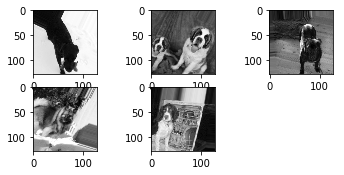

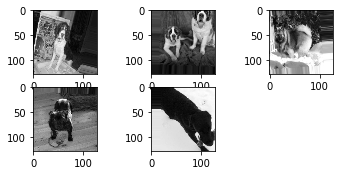

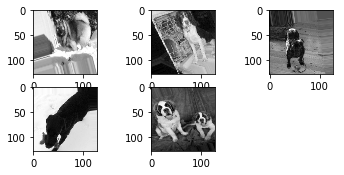

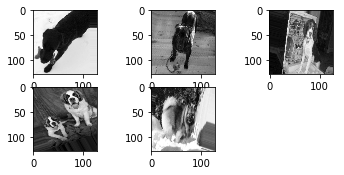

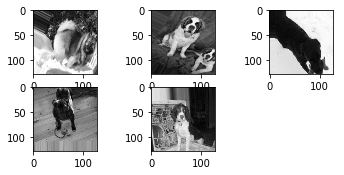

...

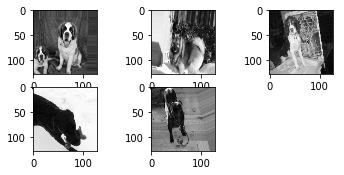

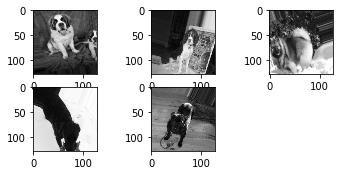

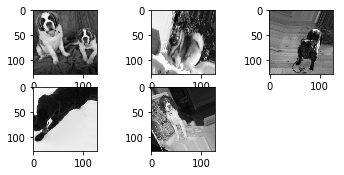

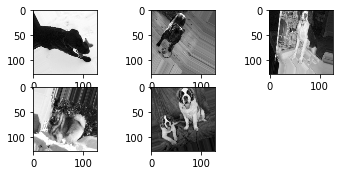

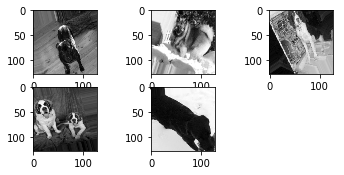

KeyboardInterrupt: ignored

In [0]:
#generated image 
for X_batch, y_batch in train_datagen.flow(x_train_datagen, x_train_datagen, batch_size=5):
	# create a grid of 3x3 images
	for i in range(0, 5):
		plt.subplot(330 + 1 + i)
		plt.imshow(X_batch[i].reshape(128, 128), cmap=plt.get_cmap('gray'))
	# show the plot
	plt.show()

### Fit the model using fit_generator() using `train_generator` and `val_generator` from the above step with 10 epochs

In [0]:
history=model.fit_generator(train_set,
                      steps_per_epoch = 500,
                      validation_data = val_set,
                      validation_steps = 4,
                      epochs = 20,
                      verbose = 1)

Epoch 1/20
500/500 [==============================] - 22s 43ms/step - loss: 4.7848 - acc: 0.0105 - val_loss: 4.7886 - val_acc: 0.0078
Epoch 2/20
500/500 [==============================] - 23s 47ms/step - loss: 4.7794 - acc: 0.0118 - val_loss: 4.7832 - val_acc: 0.0078
Epoch 3/20
500/500 [==============================] - 22s 43ms/step - loss: 4.7776 - acc: 0.0106 - val_loss: 4.7647 - val_acc: 0.0234
Epoch 4/20
500/500 [==============================] - 22s 44ms/step - loss: 4.7767 - acc: 0.0121 - val_loss: 4.8056 - val_acc: 0.0156
Epoch 5/20
500/500 [==============================] - 22s 44ms/step - loss: 4.7756 - acc: 0.0121 - val_loss: 4.8156 - val_acc: 0.0000e+00
Epoch 6/20
500/500 [==============================] - 23s 46ms/step - loss: 4.7756 - acc: 0.0122 - val_loss: 4.7839 - val_acc: 0.0234
Epoch 7/20
500/500 [==============================] - 22s 44ms/step - loss: 4.7760 - acc: 0.0124 - val_loss: 4.7660 - val_acc: 0.0156
Epoch 8/20
500/500 [==============================] - 22s 

# Model accuracy is still poor!!!

### Lets use Transfer Learning

Download the vgg wieght file from here : https://github.com/MinerKasch/applied_deep_learning/blob/master/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5

Use the below code to load VGG16 weights trained on ImageNet

In [0]:
from keras.applications.vgg16 import VGG16, preprocess_input
# Instantiate the model with the pre-trained weights (no top)
base_model= VGG16(weights=(project_path+'vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5'),
                 include_top=False, pooling='avg')

Print the summary of the base_model

In [0]:
base_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, None, None, 3)     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0         
__________

In [0]:
from tqdm import tqdm
import cv2
X_feature = []
Y_feature = []

i = 0 # initialisation
for f, img in tqdm(labels.values): # f for format ,jpg
    train_img = cv2.imread('./train/{}.jpg'.format(f),1)
    label = one_hot_labels[i]
    train_img_resize = cv2.resize(train_img, (img_rows, img_cols)) 
    X_feature.append(train_img_resize)
    Y_feature.append(label)
    i += 1

100%|██████████| 10222/10222 [00:24<00:00, 411.23it/s]


In [0]:
#preparing the train image to pass it on the convolution network
from keras.preprocessing import image

X_arr = []

for id, label in tqdm(labels.values):
    X_arr.append(base_model.predict(preprocess_input(np.expand_dims(img_to_array(image.load_img('./train/'+id+'.jpg', target_size=[128,128])), axis=0)))[0])
X = pd.DataFrame(X_arr)

100%|██████████| 10222/10222 [01:19<00:00, 129.67it/s]


In [0]:
X.shape

(10222, 512)

### Add the following classification layers to the imported VGG Model <br>
1. Flatten Layer
2. Dense layer with 1024 neurons with activation as Relu
3. Dense layer with 256 neurons with activation as Relu
4. Dense layer with 120 neurons with activation as Softmax

In [0]:
from keras.layers import Activation
model = Sequential([
    Dense(1024, input_shape=(512,)),
    Activation('relu'),
    Dense(256, input_shape=(512,)),
    Activation('relu'),
    Dense(120),
    Activation('softmax'),
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [0]:
X_train = X
y_train = Y_feature

### Make all the layers in the base_model (VGG16) to be non-trainable

In [0]:
for layer in base_model.layers:
    layer.trainable = False
pd.set_option('max_colwidth', -1)
layers = [(layer, layer.name, layer.trainable) for layer in base_model.layers]
pd.DataFrame(layers, columns=['Layer Type', 'Layer Name', 'Layer Trainable']) 

,Layer Type,Layer Name,Layer Trainable
0,<keras.engine.input_layer.InputLayer object at 0x7f902f4a6748>,input_1,False
1,<keras.layers.convolutional.Conv2D object at 0x7f902f4b0780>,block1_conv1,False
2,<keras.layers.convolutional.Conv2D object at 0x7f902f4b07b8>,block1_conv2,False
3,<keras.layers.pooling.MaxPooling2D object at 0x7f902f4b9b00>,block1_pool,False
4,<keras.layers.convolutional.Conv2D object at 0x7f902f4b9a20>,block2_conv1,False
5,<keras.layers.convolutional.Conv2D object at 0x7f902e720978>,block2_conv2,False
6,<keras.layers.pooling.MaxPooling2D object at 0x7f902e23bac8>,block2_pool,False
7,<keras.layers.convolutional.Conv2D object at 0x7f902e23be10>,block3_conv1,False
8,<keras.layers.convolutional.Conv2D object at 0x7f902e23fc50>,block3_conv2,False
9,<keras.layers.convolutional.Conv2D object at 0x7f902e879cc0>,block3_conv3,False


### Fit and compile the model with batch_size = 128 and epochs = 10 and execute the model

Try to get training and validation accuracy to be more than 90%

In [0]:
model.fit(X_train, np.asarray(y_train), epochs=10, batch_size=128, verbose=True)

Epoch 1/10
10222/10222 [==============================] - 1s 74us/step - loss: 4.7965 - acc: 0.1565
Epoch 2/10
10222/10222 [==============================] - 0s 42us/step - loss: 2.2184 - acc: 0.4348
Epoch 3/10
10222/10222 [==============================] - 0s 44us/step - loss: 1.4761 - acc: 0.5871
Epoch 4/10
10222/10222 [==============================] - 0s 42us/step - loss: 1.0003 - acc: 0.7113
Epoch 5/10
10222/10222 [==============================] - 0s 44us/step - loss: 0.6546 - acc: 0.8108
Epoch 6/10
10222/10222 [==============================] - 0s 43us/step - loss: 0.3903 - acc: 0.8925
Epoch 7/10
10222/10222 [==============================] - 0s 44us/step - loss: 0.1969 - acc: 0.9546
Epoch 8/10
10222/10222 [==============================] - 0s 43us/step - loss: 0.1133 - acc: 0.9763
Epoch 9/10
10222/10222 [==============================] - 0s 43us/step - loss: 0.0663 - acc: 0.9908
Epoch 10/10
10222/10222 [==============================] - 0s 43us/step - loss: 0.0311 - acc: 0.9977